## Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

---
## First, I'll compute the camera calibration using chessboard images

In [1]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
import pickle

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.
    
def calibrate_camera(img, nx = 9, ny = 6):
    
    
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (nx,ny),None)
    
    warped = img
    # If found, add object points, image points
    if ret == True:
        img_size = (gray.shape[1], gray.shape[0])
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        #img = cv2.drawChessboardCorners(img, (9,6), corners, ret)
        src = np.float32([corners[0],corners[nx-1],corners[-1],corners[-nx]])
        # c) define 4 destination points dst = np.float32([[,],[,],[,],[,]])
        dst = np.float32([[100,100],[img_size[0]-100,100],[img_size[0]-100,img_size[1]-100],[100,img_size[1]-100]])
        # d) use cv2.getPerspectiveTransform() to get M, the transform matrix
        M = cv2.getPerspectiveTransform(src, dst)
        # e) use cv2.warpPerspective() to warp your image to a top-down view
        
        ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size, None, None)
        
        undist = cv2.undistort(img, mtx, dist, None, mtx)
        
        warped = cv2.warpPerspective(undist, M, img_size)
    
    return warped

# Make a list of calibration images
images = glob.glob('./camera_cal/calibration*.jpg')

# Step through the list and search for chessboard corners
for fname in images:
    img = cv2.imread(fname)
    warped = calibrate_camera(img)
    
    output_filename = "output_images/" + fname[13:]

    
    #output to files
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(warped)
    ax2.set_title('Undistorted and Warped Image', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.savefig(output_filename)

img_size = (img.shape[1], img.shape[0])
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size, None, None)

# Save the camera calibration result for later use 
print("Saving the parameter to file...>>camera_cal.p")
dist_pickle = {}
dist_pickle["mtx"] = mtx
dist_pickle["dist"] = dist
pickle_file = open("camera_cal.p", "wb")
pickle.dump(dist_pickle, pickle_file)
pickle_file.close()


Saving the parameter to file...>>camera_cal.p


## And so on and so forth...

/opt/conda/lib/python3.6/site-packages/matplotlib/pyplot.py:523: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


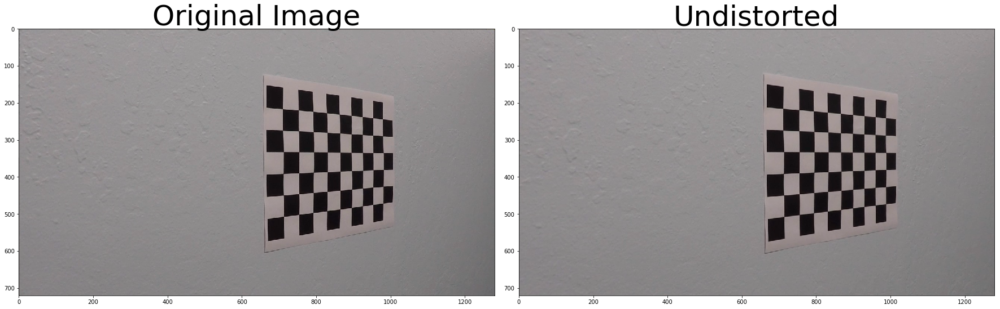

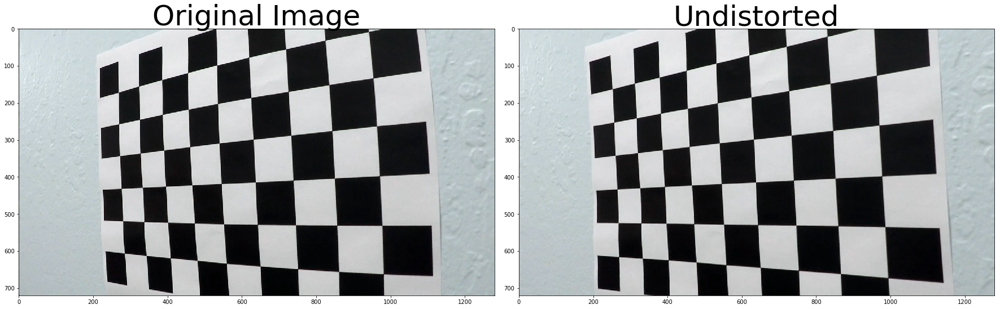

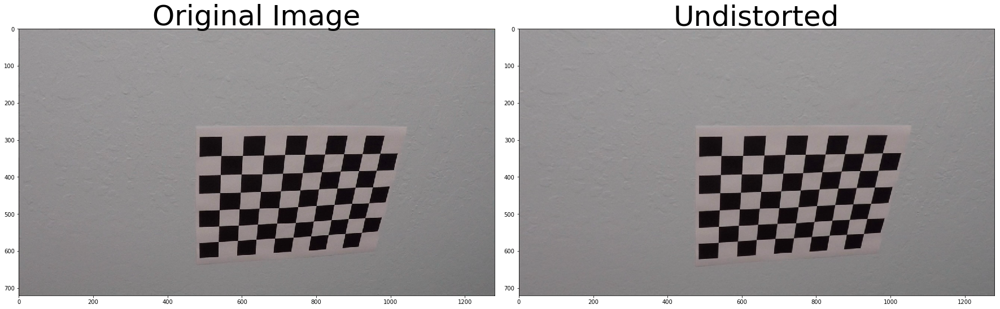

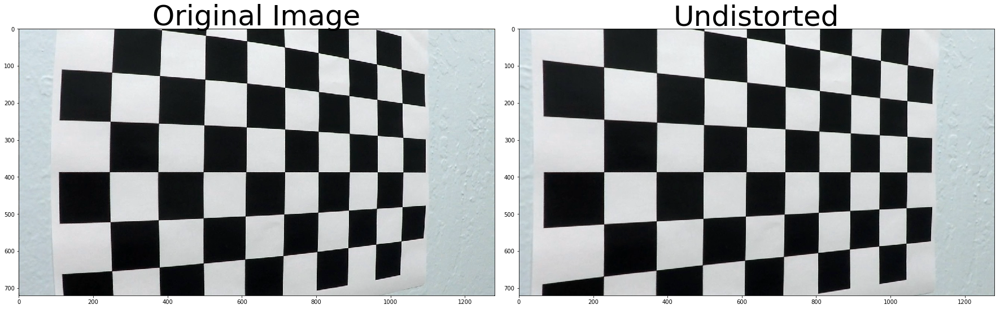

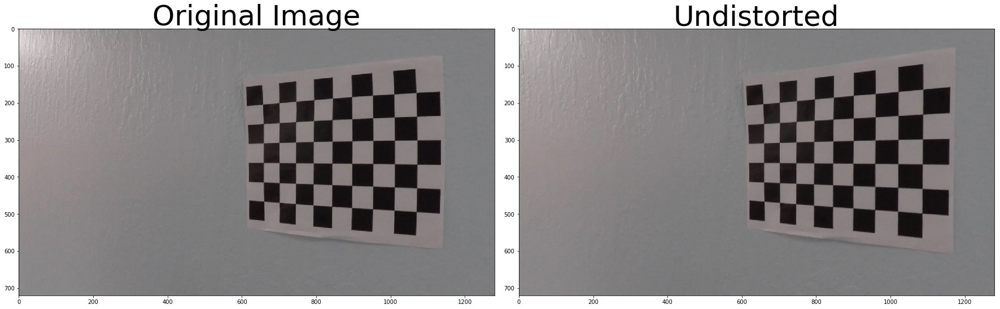

...

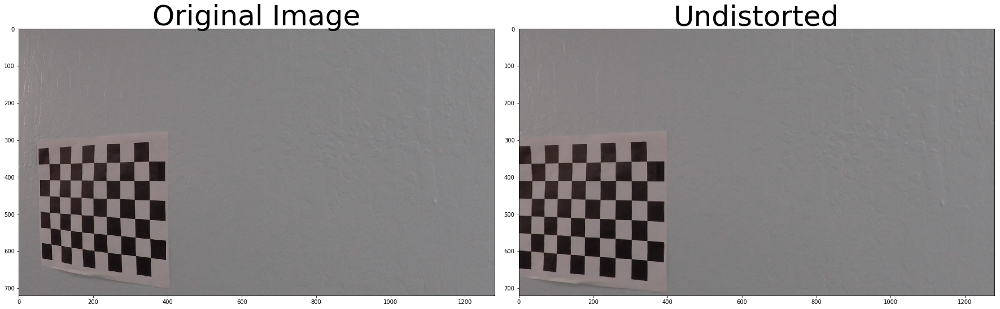

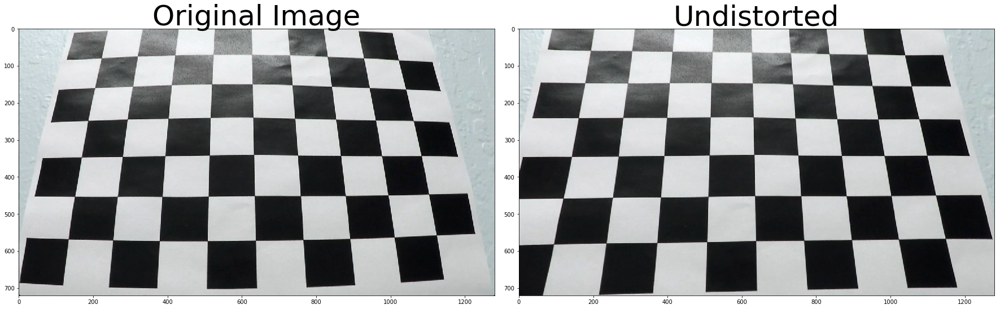

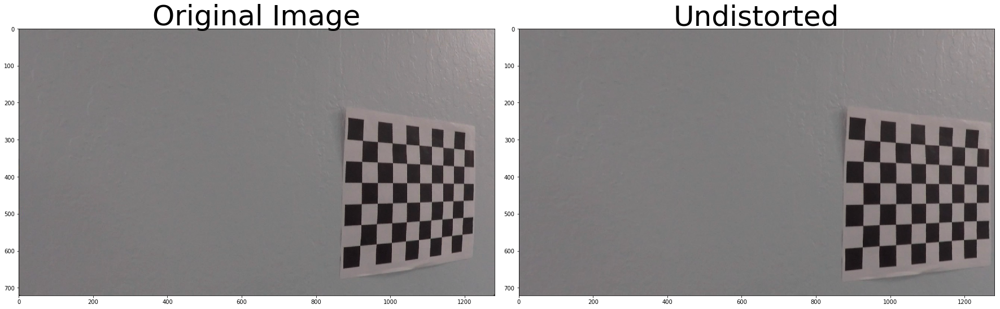

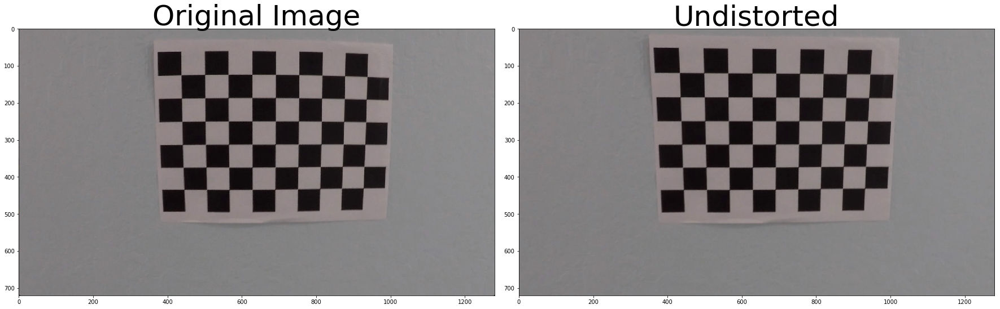

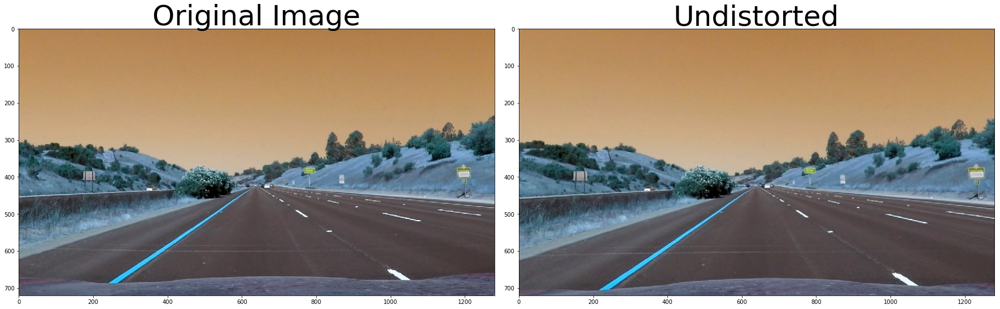

In [2]:
def undistort(image):
    pickle_file = open("./camera_cal.p", "rb")
    dist_pickle = pickle.load(pickle_file)
    mtx = dist_pickle["mtx"]  
    dist = dist_pickle["dist"]
    pickle_file.close()
    
    undist = cv2.undistort(image, mtx, dist, None, mtx)
    
    return undist

# Make a list of calibration images
images = glob.glob('./camera_cal/calibration*.jpg')

# Step through the list and search for chessboard corners
for fname in images:
    img = cv2.imread(fname)
    undistorted_image = undistort(img)
    
    output_filename = "output_images/undistorted_" + fname[13:]

    #output to files
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(undistorted_image)
    ax2.set_title('Undistorted', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.savefig(output_filename)
    
img = cv2.imread("./test_images/straight_lines1.jpg")
undistorted_image = undistort(img)

output_filename = "output_images/undistorted_straight_lines1.jpg"

#output to files
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(undistorted_image)
ax2.set_title('Undistorted', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
plt.savefig(output_filename)

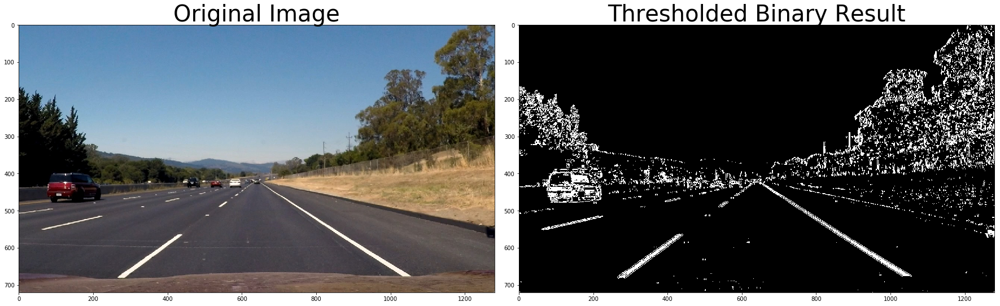

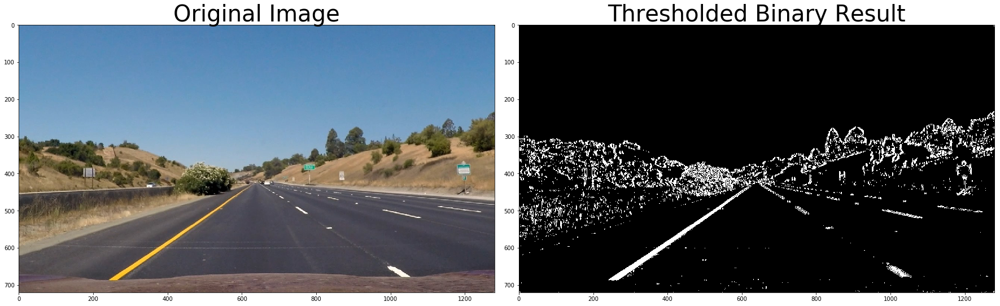

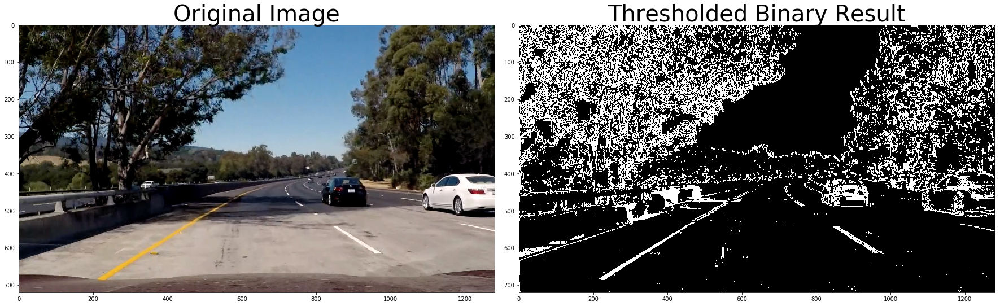

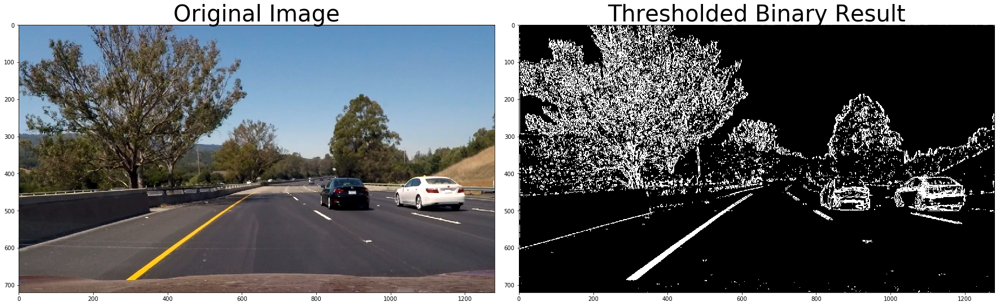

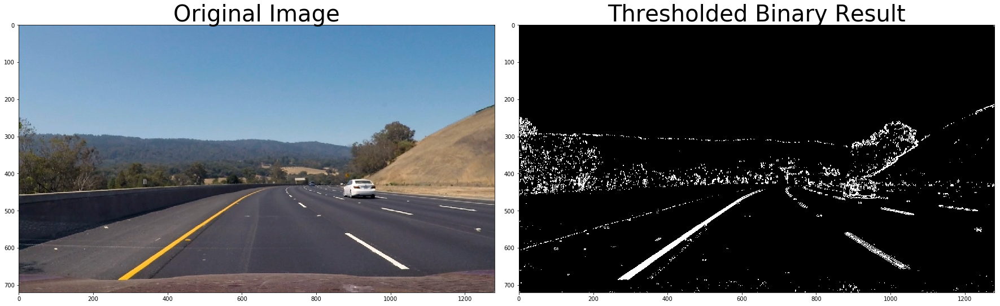

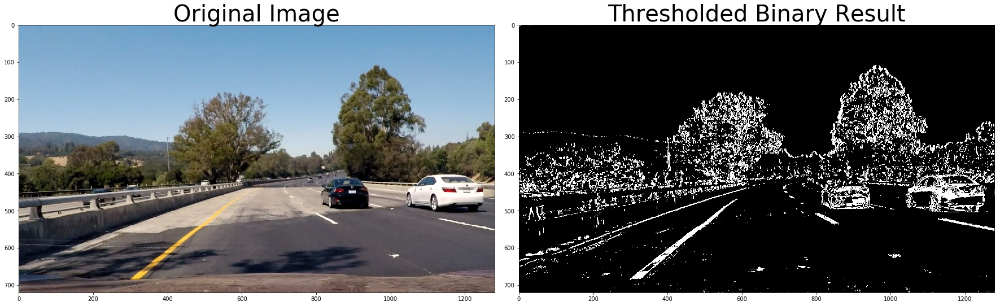

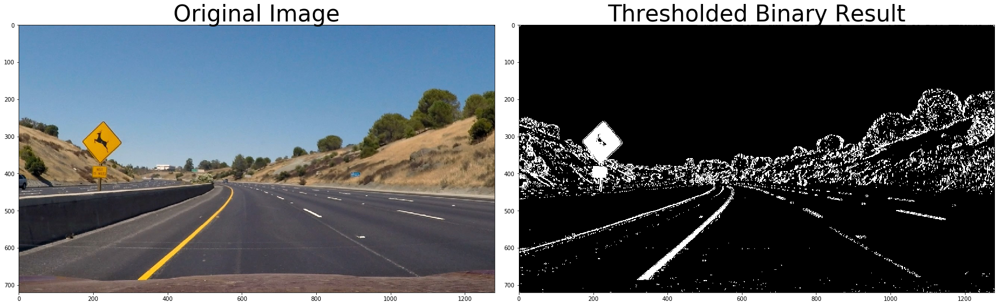

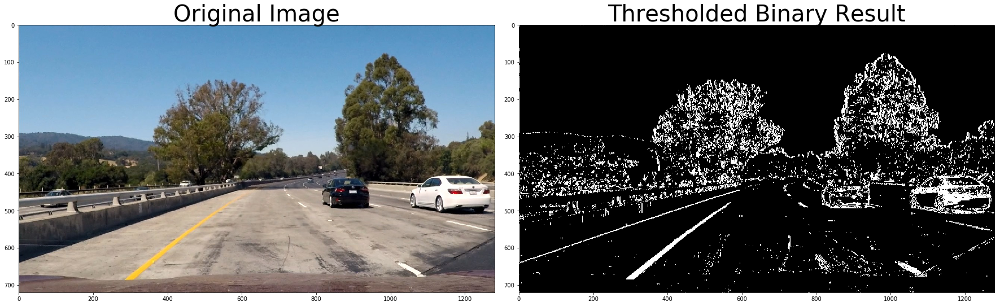

In [3]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Edit this function to create your own pipeline.
def get_binary_image(img, s_thresh=(170, 255), sx_thresh=(20, 100)):
    img = np.copy(img)
    # Convert to HLS color space and separate the V channel
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    l_channel = hls[:,:,1]
    s_channel = hls[:,:,2]
    # Sobel x
    sobelx = cv2.Sobel(l_channel, cv2.CV_64F, 1, 0, ksize=5) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
    # Threshold x gradient
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1
    
    # Threshold color channel
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    # Stack each channel
    #color_binary = np.dstack(( np.zeros_like(sxbinary), sxbinary, s_binary)) * 255
    
    binary = sxbinary | s_binary
    return binary
    
images = glob.glob('./test_images/straight_lines*.jpg')

# Step through the list and search for chessboard corners
for fname in images:
    image = mpimg.imread(fname)
    t_binary_image = get_binary_image(image)

    output_filename = "output_images/binary_" + fname[14:]
    
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()

    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=40)

    ax2.imshow(t_binary_image, cmap='gray')
    ax2.set_title('Thresholded Binary Result', fontsize=40)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.savefig(output_filename)
    
images = glob.glob('./test_images/test*.jpg')

# Step through the list and search for chessboard corners
for fname in images:
    image = mpimg.imread(fname)
    t_binary_image = get_binary_image(image)

    output_filename = "output_images/binary_" + fname[14:]
    
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()

    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=40)

    ax2.imshow(t_binary_image, cmap='gray')
    ax2.set_title('Thresholded Binary Result', fontsize=40)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.savefig(output_filename)
    

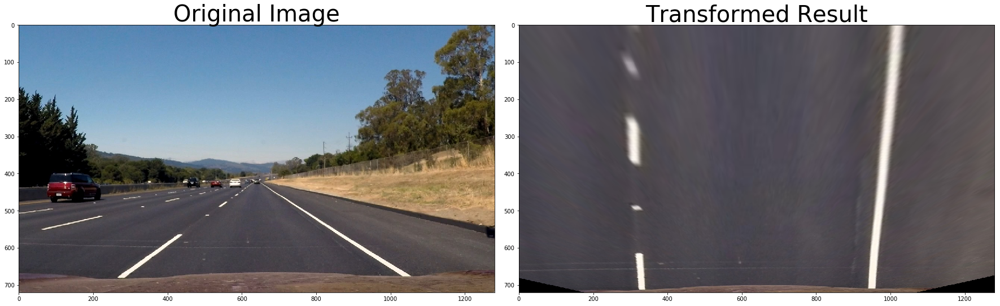

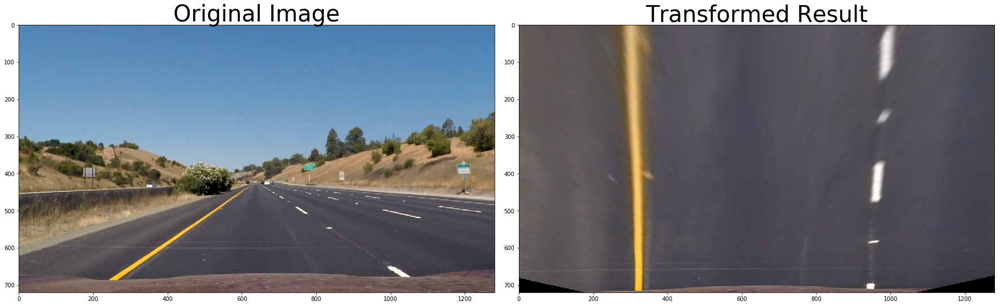

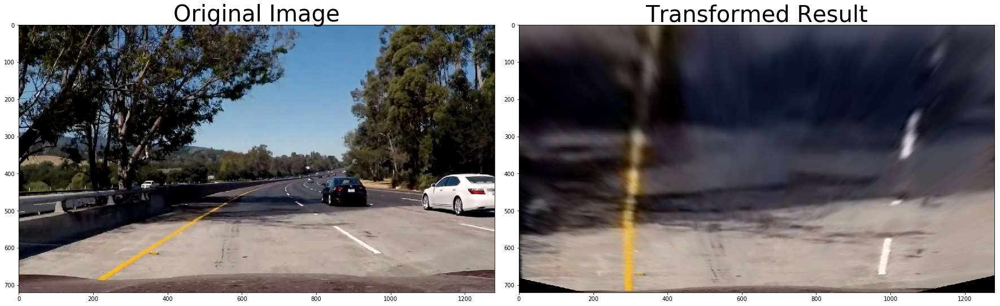

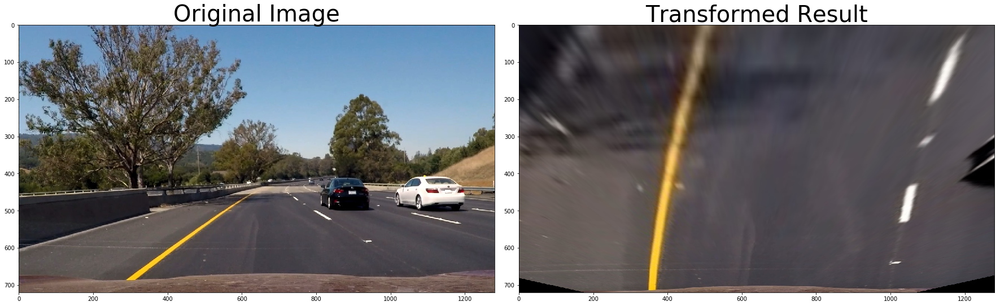

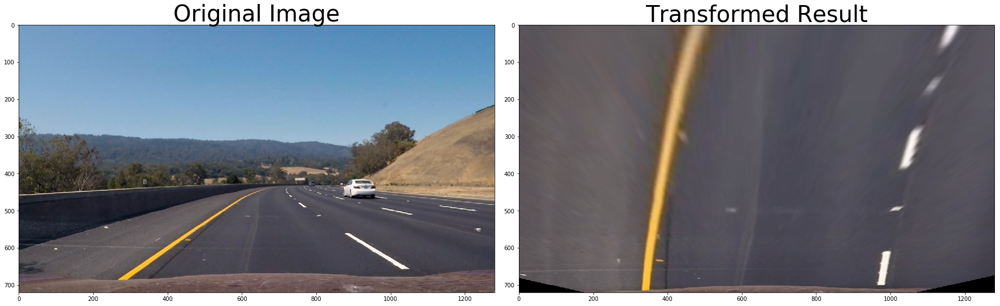

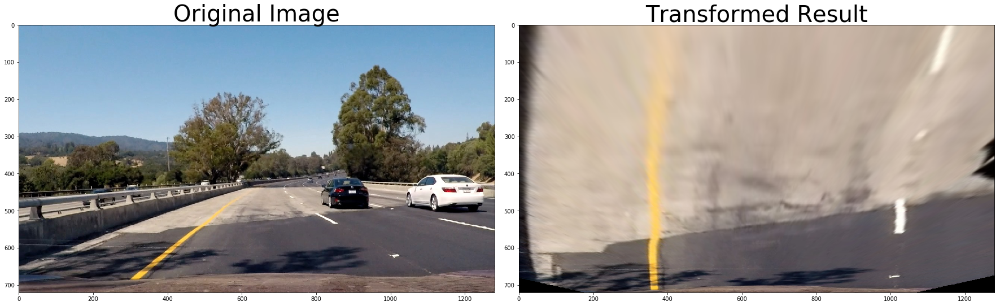

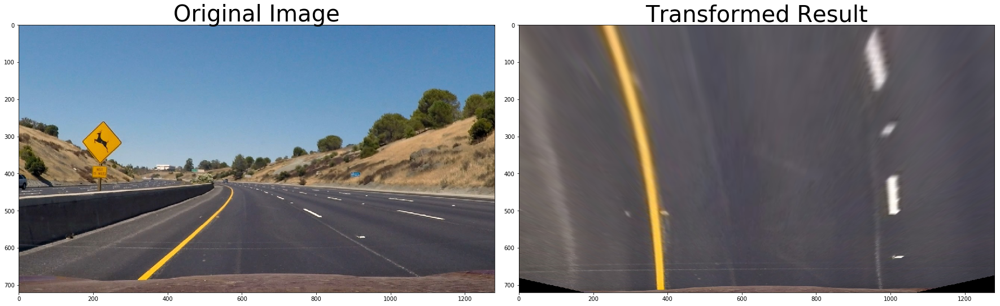

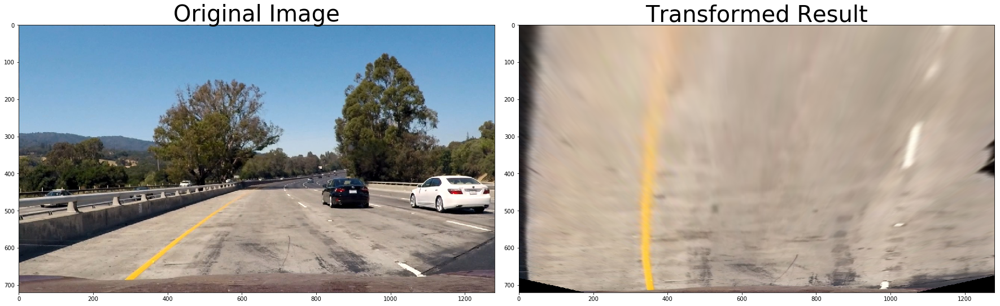

In [4]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

"""corners = [  (592,  450) ,
              (686,  450) ,
             (1022,  660) ,
              (280,  660) ]
destination = [  (200,  200) ,
          (image.shape[1]-200,  200) ,
         (image.shape[1]-200,  image.shape[0]) ,
          (200,  image.shape[0]) ]"""

def get_perspective_transform(img):
    pickle_file = open("./camera_cal.p", "rb")
    dist_pickle = pickle.load(pickle_file)
    mtx = dist_pickle["mtx"]  
    dist = dist_pickle["dist"]
    pickle_file.close()
    
    # Use the OpenCV undistort() function to remove distortion
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    # Convert undistorted image to grayscale
    #gray = cv2.cvtColor(undist, cv2.COLOR_BGR2GRAY)
    img_size = (img.shape[1], img.shape[0])
    offset = 100
    
    src = np.float32(
        [[(img_size[0] / 2) - 55, img_size[1] / 2 + 100],
        [((img_size[0] / 6) - 10), img_size[1]],
        [(img_size[0] * 5 / 6) + 60, img_size[1]],
        [(img_size[0] / 2 + 55), img_size[1] / 2 + 100]])
    dst = np.float32(
        [[(img_size[0] / 4), 0],
        [(img_size[0] / 4), img_size[1]],
        [(img_size[0] * 3 / 4), img_size[1]],
        [(img_size[0] * 3 / 4), 0]])
        
    # For source points I'm grabbing the outer four detected corners
    #src = np.float32([corners[0], corners[1], corners[2], corners[3]])
    # For destination points, I'm arbitrarily choosing some points to be
    # a nice fit for displaying our warped result 
    # again, not exact, but close enough for our purposes
    #dst = np.float32([destination[0], destination[1], destination[2], destination[3]])
    # Given src and dst points, calculate the perspective transform matrix
    M = cv2.getPerspectiveTransform(src, dst)
    # Warp the image using OpenCV warpPerspective()
    warped = cv2.warpPerspective(undist, M, img_size)

    # Return the resulting image and matrix
    return warped

images = glob.glob('./test_images/straight_lines*.jpg')

# Step through the list and search for chessboard corners
for fname in images:
    image = mpimg.imread(fname)
    #binary_image = get_binary_image(image)
    t_binary_image = get_perspective_transform(image)

    output_filename = "output_images/p_transform_" + fname[14:]
    
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()

    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=40)

    ax2.imshow(t_binary_image, cmap='gray')
    ax2.set_title('Transformed Result', fontsize=40)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.savefig(output_filename)
    
images = glob.glob('./test_images/test*.jpg')

# Step through the list and search for chessboard corners
for fname in images:
    image = mpimg.imread(fname)
    #binary_image = get_binary_image(image)
    t_binary_image = get_perspective_transform(image)

    output_filename = "output_images/p_transform_" + fname[14:]
    
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()

    ax1.imshow(image)
    """x = [corners[0][0], corners[1][0], corners[2][0], corners[3][0], corners[0][0]]
    y = [corners[0][1], corners[1][1], corners[2][1], corners[3][1], corners[0][1]]
    ax1.plot(x, y, 'b--', lw=4)"""
    ax1.set_title('Original Image', fontsize=40)

    ax2.imshow(t_binary_image, cmap="gray")
    ax2.set_title('Transformed Result', fontsize=40)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.savefig(output_filename)

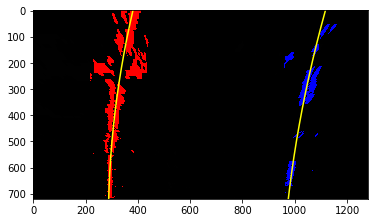

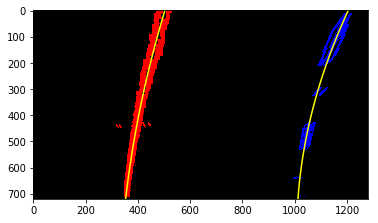

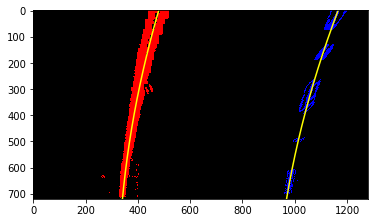

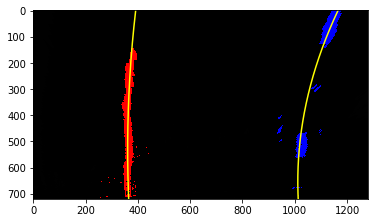

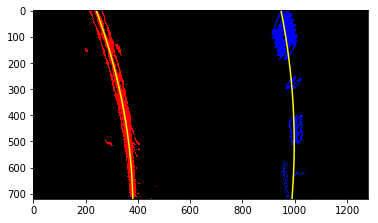

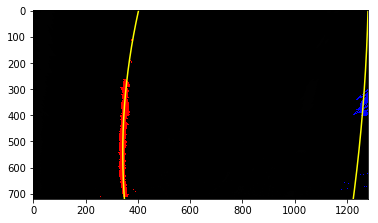

In [8]:
import cv2
import numpy as np
import matplotlib.image as mpimg
import matplotlib.pyplot as plt

class Line():
    def __init__(self):
        # was the line detected in the last iteration?
        self.detected = False  
        # x values of the last n fits of the line
        self.recent_xfitted = [0 for i in range(720)]
        #average x values of the fitted line over the last n iterations
        self.bestx = None     
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None  
        #polynomial coefficients for the most recent fit
        self.current_fit = [np.array([False])]  
        #radius of curvature of the line in some units
        self.curverad = None 
        #distance in meters of vehicle center from the line
        self.offset = None 
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float') 
        #x values for detected line pixels
        self.allx = None  
        #y values for detected line pixels
        self.ally = None  
        self.ploty = None
        
def find_lane_pixels(binary_warped):
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 18
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 150

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        ### TO-DO: Find the four below boundaries of the window ###
        win_xleft_low = leftx_current - margin  # Update this
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        
        # Draw the windows on the visualization image
        """cv2.rectangle(out_img,(win_xleft_low,win_y_low),
        (win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),
        (win_xright_high,win_y_high),(0,255,0), 2) """
        
        ### TO-DO: Identify the nonzero pixels in x and y within the window ###
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        ### TO-DO: If you found > minpix pixels, recenter next window ###
        ### (`right` or `leftx_current`) on their mean position ###
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        pass

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    return leftx, lefty, rightx, righty, out_img


def fit_polynomial(binary_warped, lineL, LineR):
    # Find our lane pixels first
    leftx, lefty, rightx, righty, out_img = find_lane_pixels(binary_warped)

        
    ### TO-DO: Fit a second order polynomial to each using `np.polyfit` ###
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx = 1*ploty**2 + 1*ploty
        right_fitx = 1*ploty**2 + 1*ploty

    ## Visualization ##
    # Colors in the left and right lane regions
    out_img[lefty, leftx] = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]

    # Plots the left and right polynomials on the lane lines
    #plt.plot(left_fitx, ploty, color='yellow')
    #plt.plot(right_fitx, ploty, color='yellow')
    
    curverad_l, curverad_r, center_offset = measure_curvature_real(ploty, lefty, leftx, righty, rightx, binary_warped.shape[1])
    #print(center_offset)
    lineL.curverad = curverad_l
    lineL.offset = center_offset
    lineR.curverad = curverad_r
    lineR.offset = center_offset
    
    """plt.clf()
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')
    plt.imshow(out_img)
    plt.show()"""
    
    #print("curve diff:", curverad_l - curverad_r, curverad_l, curverad_r)
    #print("right fit already got problem")
    #print(right_fitx)
    return out_img, ploty, left_fit, right_fit, left_fitx, right_fitx 

def measure_curvature_real(ploty, lefty, leftx, righty, rightx, img_width):
    '''
    Calculates the curvature of polynomial functions in meters.
    '''
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    
    # Start by generating our fake example data
    # Make sure to feed in your real data instead in your project!
    #ploty, left_fit_cr, right_fit_cr = generate_data(ym_per_pix, xm_per_pix)
    # fit the polynomial
    left_fit_cr = np.polyfit(lefty, leftx, 2)
    right_fit_cr = np.polyfit(righty, rightx, 2)
    
    # Define y-value where we want radius of curvature
    # We'll choose the maximum y-value, corresponding to the bottom of the image
    y_eval = np.max(ploty)
    
    ##### TO-DO: Implement the calculation of R_curve (radius of curvature) #####
    # Calculation of R_curve (radius of curvature)
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    
    left_point = np.poly1d(left_fit_cr)(y_eval)
    right_point = np.poly1d(right_fit_cr)(y_eval)

    lane_center = (left_point + right_point) / 2 * xm_per_pix
    image_center = img_width * xm_per_pix / 2

    offset = lane_center - image_center
    
    return left_curverad, right_curverad, offset

lineR = Line()
lineL = Line()
#lineR.recent_xfitted = range(1000)
#lineL.recent_xfitted = range(1000)
#print("lineR", len(lineL.recent_xfitted))
images = glob.glob('./test_images/straight_lines*.jpg')

# Step through the list and search for chessboard corners
for fname in images:
    image = mpimg.imread(fname)
    binary_image = get_binary_image(image)
    transformed_image = get_perspective_transform(binary_image)
    
    out_img, ploty, left_fit, right_fit, left_fitx, right_fitx = fit_polynomial(transformed_image, lineL, lineR)

    output_filename = "output_images/polynomial_" + fname[14:]
    
    # Plot the result
    plt.imshow(out_img)
    plt.savefig(output_filename)

images = glob.glob('./test_images/test*.jpg')

# Step through the list and search for chessboard corners
for fname in images:
    image = mpimg.imread(fname)
    binary_image = get_binary_image(image)
    transformed_image = get_perspective_transform(binary_image)
    out_img, ploty, left_fit, right_fit, left_fitx, right_fitx = fit_polynomial(transformed_image, lineL, lineR)

    plt.clf()
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')

    output_filename = "output_images/polynomial_" + fname[14:]
    
    # Plot the result
    plt.imshow(out_img)
    plt.show()
    plt.savefig(output_filename)

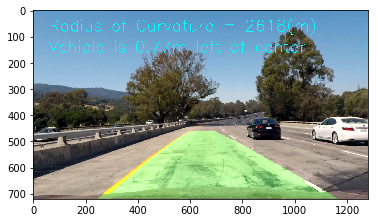

In [6]:


def fill_lanes(img, lineL, LineR):
    pickle_file = open("./camera_cal.p", "rb")
    dist_pickle = pickle.load(pickle_file)
    mtx = dist_pickle["mtx"]  
    dist = dist_pickle["dist"]
    pickle_file.close()
    
    binary_image = get_binary_image(img)

    # Use the OpenCV undistort() function to remove distortion
    undist = cv2.undistort(binary_image, mtx, dist, None, mtx)
    undist_color = cv2.undistort(img, mtx, dist, None, mtx)
    # Convert undistorted image to grayscale
    #gray = cv2.cvtColor(undist, cv2.COLOR_BGR2GRAY)
    img_size = (img.shape[1], img.shape[0])
    offset = 100
    
    src = np.float32(
        [[(img_size[0] / 2) - 55, img_size[1] / 2 + 100],
        [((img_size[0] / 6) - 10), img_size[1]],
        [(img_size[0] * 5 / 6) + 60, img_size[1]],
        [(img_size[0] / 2 + 55), img_size[1] / 2 + 100]])
    dst = np.float32(
        [[(img_size[0] / 4), 0],
        [(img_size[0] / 4), img_size[1]],
        [(img_size[0] * 3 / 4), img_size[1]],
        [(img_size[0] * 3 / 4), 0]])

    # For source points I'm grabbing the outer four detected corners
    #src = np.float32([corners[0], corners[1], corners[2], corners[3]])
    # For destination points, I'm arbitrarily choosing some points to be
    # a nice fit for displaying our warped result 
    # again, not exact, but close enough for our purposes
    #dst = np.float32([destination[0], destination[1], destination[2], destination[3]])
    # Given src and dst points, calculate the perspective transform matrix
    M = cv2.getPerspectiveTransform(src, dst)
    M_inverse = cv2.getPerspectiveTransform(dst, src)
    # Warp the image using OpenCV warpPerspective()
    warped = cv2.warpPerspective(undist, M, img_size)

    out_img, ploty, left_fit, right_fit, left_fitx, right_fitx  = fit_polynomial(warped, lineL, LineR)
    #print("after??")
    #print(right_fitx)
    if ((abs(left_fitx[0] - lineL.recent_xfitted[0]) > 100 or
       abs(left_fitx[350] - lineL.recent_xfitted[350]) > 100 or
       abs(left_fitx[700] - lineL.recent_xfitted[700]) > 100) and
       lineL.recent_xfitted[0] != 0):
        """print("length", len(left_fitx), len(right_fitx), len(lineL.recent_xfitted), len(lineR.recent_xfitted))
        print("left current/previous:")
        print(left_fitx[0], 
             left_fitx[350],
             left_fitx[700])
        print(lineL.recent_xfitted[0], 
             lineL.recent_xfitted[350],
             lineL.recent_xfitted[700])
        print("####left diff:")
        print(left_fitx[0] - lineL.recent_xfitted[0], 
             left_fitx[350] - lineL.recent_xfitted[350],
             left_fitx[700] - lineL.recent_xfitted[700])"""
        
        left_fitx = lineL.recent_xfitted
    else:
        lineL.recent_xfitted = left_fitx
        
    if ((abs(right_fitx[0] - lineR.recent_xfitted[0]) > 100 or
       abs(right_fitx[350] - lineR.recent_xfitted[350]) > 100 or
       abs(right_fitx[700] - lineR.recent_xfitted[700]) > 100) and
       lineR.recent_xfitted[0] != 0):
        """print("right current/previous:")
        print(right_fitx[0] ,
             right_fitx[350],
             right_fitx[700])
        print(lineR.recent_xfitted[0] ,
             lineR.recent_xfitted[350],
             lineR.recent_xfitted[700])
        print("####right diff:")
        print(right_fitx[0] - lineR.recent_xfitted[0],
             right_fitx[350] - lineR.recent_xfitted[350],
             right_fitx[700] - lineR.recent_xfitted[700])"""
        
        right_fitx = lineR.recent_xfitted
    else:
        lineR.recent_xfitted = right_fitx
    
    
    
    # Create an image to draw the lines on
    warp_zero = np.zeros(undist.shape[:2], dtype=np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    #print("compare left:")
    #print(left_fitx)
    #left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    #print(left_fitx)
    #print("compare right")
    #print(right_fitx)
    #right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    #print(right_fitx)
    
    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))
        
    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
    
    unwarped_img = cv2.warpPerspective(color_warp, M_inverse, img_size)
    # Return the resulting image and matrix
    #print("undist", undist.shape, unwarped_img.shape)
    ### corrected reveiw#2: draw on undistorted image
    image_lane_highlighted = cv2.addWeighted(undist_color, 1, unwarped_img, 0.3, 0)
    
    return image_lane_highlighted, ploty, left_fit, right_fit

def write_text(img, lineL, lineR):

    str_cur = "Radius of Curvature = {}(m)".format(int(lineL.curverad))

    if lineL.offset > 0:
        direction = "left"
    else:
        direction = "right"

    str_offset = "Vehicle is {0:.2f}m ".format(abs(lineL.offset)) + "{} of center".format(direction)
    cv2.putText(img, str_cur, (60,80), cv2.FONT_HERSHEY_SIMPLEX,2,(0,255,255),2)
    cv2.putText(img, str_offset, (60,160), cv2.FONT_HERSHEY_SIMPLEX,2,(0,255,255),2)

    return img

lineL = Line()
lineR = Line()
images = glob.glob('./test_images/straight_lines*.jpg')

# Step through the list and search for chessboard corners
for fname in images:
    image = mpimg.imread(fname)
    image_lane_highlighted, ploty, left_fit, right_fit = fill_lanes(image, lineL, lineR)

    plt.clf()

    image_lane_text = write_text(image_lane_highlighted, lineL, lineR)
    plt.imshow(image_lane_text)

    output_filename = "output_images/Lane_Text_" + fname[14:]
    
    # Plot the result
    plt.savefig(output_filename)
    
images = glob.glob('./test_images/test*.jpg')

# Step through the list and search for chessboard corners
for fname in images:
    image = mpimg.imread(fname)
    image_lane_highlighted, ploty, left_fit, right_fit = fill_lanes(image, lineL, lineR)

    plt.clf()

    image_lane_text = write_text(image_lane_highlighted, lineL, lineR)
    plt.imshow(image_lane_text)

    output_filename = "output_images/Lane_Text_" + fname[14:]
    
    # Plot the result
    plt.savefig(output_filename)

In [ ]:
"""import imageio
imageio.plugins.ffmpeg.download()
pip install imageio-ffmpeg"""

from moviepy.editor import VideoFileClip
from IPython.display import HTML

g_left_line = Line()
g_right_line = Line()
    
def process_image(image):
    image_lane_highlighted, ploty, left_fit, right_fit = fill_lanes(image, g_left_line, g_right_line)
    
    image_lane_text = write_text(image_lane_highlighted, g_left_line, g_right_line)
    return image_lane_highlighted


white_output = 'project_video_processed.mp4'
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
#clip1 = VideoFileClip("project_video.mp4").subclip(40, 42)
clip1 = VideoFileClip("project_video.mp4")
white_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time white_clip.write_videofile(white_output, audio=False)

[MoviePy] >>>> Building video project_video_processed.mp4
[MoviePy] Writing video project_video_processed.mp4


 69%|██████▉   | 876/1261 [04:02<01:46,  3.62it/s]